# Description

Somewhat cleaner notebook for exploring learning IVs, in the linear case.

# Imports

In [1]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import multiprocessing

import numpy as np
import pandas as pd
import seaborn as sns

from ipywidgets import interact_manual, IntSlider, FloatSlider
from sklearn.linear_model import LinearRegression
from linearmodels.iv.model import IV2SLS
from linearmodels.iv.model import _OLS

%matplotlib inline

import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 300
from mpl_toolkits.axes_grid1 import make_axes_locatable

from tqdm import tqdm

In [2]:
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import mean_squared_error as mse
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor

from econml.grf import RegressionForest

In [3]:
%load_ext autoreload
%autoreload 2

# Setup: linear treatment effects

We take a classic linear regression setup, where the treatment is correlated with some confounder $C$:

$$
Y = \beta + \tau T + \gamma C + \epsilon, \;\; Cov(T,C) \neq 0
$$

The estimand of interest is $\tau$, the treatment effect.

We then have an instrumental variable $Z$ such that:

$$
T = \pi Z + \psi C + \eta, \;\; Cov(Z,C) = 0
$$

In [4]:
def generate_const_linear_iv(
    n_samples,
    seed,
    pi,
    psi,
    tau,
    gamma
):
    """
    Generates linear IV with constant treatment effects.
    
    Args:
        n_samples (int): num samples to generate
        seed (int): seed for reproducibilty
        pi (float): instrument "strength"
        psi (float): confounding "strength"
        tau (float): treatment effect
        gamma (float): confound effect
    
    Returns:
        pd.DataFrame
    """
    np.random.seed(seed),
    Z = np.random.normal(0, 1, size=n_samples)#np.random.uniform(0, 10, n_samples)
    C = np.random.normal(0, 1, size=n_samples)#np.random.uniform(0, 10, n_samples)
    eta = np.random.normal(0, 1, size=n_samples)
    const = np.random.uniform(-1, 1)

    T = const + (pi*Z) + (psi*C) + eta

    epsilon = np.random.normal(0, 1, size=n_samples)
    beta = np.random.uniform(-1, 1)

    Y = beta + (tau*T) + (gamma*C) + epsilon

    data = np.concatenate([Z.reshape(-1,1), 
                           C.reshape(-1,1), 
                           T.reshape(-1,1),
                           Y.reshape(-1,1),], 
                         axis=1)

    data_df = pd.DataFrame(data, columns=['Z', 'C', 'T', 'Y'])

    return data_df


In [5]:
# generate IV data

# consts
n_samples = 1000
seed = 42
pi = 1 # IV "strength"
psi = 5 # confound "strength"

tau = 2 # treat effect
gamma = -5 # confound effect

df = generate_const_linear_iv(
        n_samples,
        seed,
        pi,
        psi,
        tau,
        gamma)

df

,Z,C,T,Y
0,0.496714,1.399355,7.455794,8.165450
1,-0.138264,0.924634,4.977866,6.099834
2,0.647689,0.059630,0.790901,1.169550
3,1.523030,-0.646937,-1.382135,0.640969
4,-0.234153,0.698223,2.000829,0.956657
...,...,...,...,...
995,-0.281100,1.070150,5.784612,6.625270
996,1.797687,-0.026521,2.560313,5.047941
997,0.640843,-0.881875,-4.372811,-3.512755
998,-0.571179,-0.163067,-0.414857,0.175355


(-10.0, 10.0)

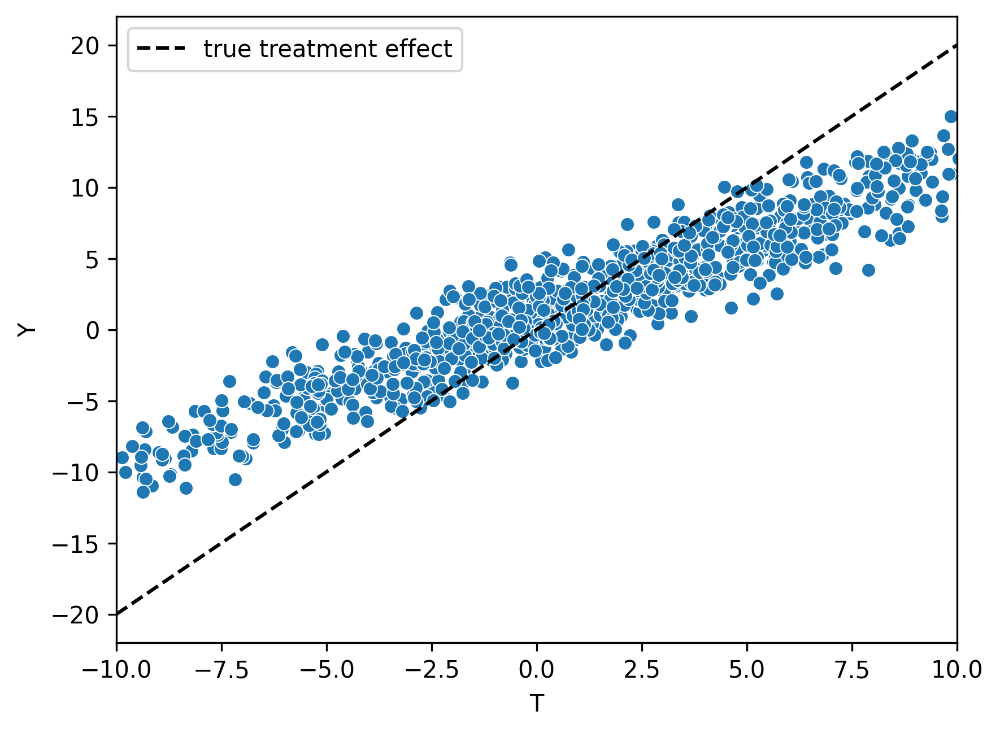

In [6]:
fig, ax = plt.subplots()
fig.patch.set_facecolor("white")
ax.plot(np.linspace(-10,10, 20), 2*np.linspace(-10,10,20), ls='--', color='black', label="true treatment effect")
sns.scatterplot(x='T', y='Y', data=df, ax=ax)
ax.set_xlim(-10,10)

In [7]:
feat_cols = [
    "mean_Z",
    "mean_T",
    "mean_Y",
    "var_Z",
    "var_T",
    "var_Y",
    "cov_ZT",
    "cov_ZY",
    "cov_TY",
    "n"
]

def generate_iv_features(data_df, confounder='C'):
    """Generates IV features from a given simple (four variable) data matrix."""
    
    data = data_df.drop(confounder, axis='columns', errors='ignore')   
    data = data[["Z", "T", "Y"]]
    
    cov_mat = np.cov(data, rowvar=False)

    var = np.diag(cov_mat).reshape(-1)
    var = var[var != 0]
    
    cov = np.array([cov_mat[0,1], cov_mat[0,2], cov_mat[1,2]])
    mean = np.mean(data, axis=0).values

    feats = np.concatenate([mean, var, cov, np.array(data_df.shape[0]).reshape(-1)])

    return pd.DataFrame(feats.reshape(1, -1), columns=feat_cols)

In [8]:
feat_df = generate_iv_features(df)

## Full simulations: varying IV strength

In [9]:
iv_strs = np.round(np.linspace(0, 2, 11), 2) 

### Regression, TSLS 

In [10]:
n_datasets = 10000
n_test_datasets = 2000

#n_samples = 1000
psi = 5 # confound "strength"

iv_mses = []
reg_mses = []

iv_stderrs = []
iv_preds = []
reg_preds = []

reg_bias = []
reg_vars = []

iv_bias = []
iv_vars = []

for pi in tqdm(iv_strs):
    print(pi)
    lin_reg_taus = np.zeros(n_test_datasets)
    tsls_taus = np.zeros(n_test_datasets)
    tsls_stderrs = np.zeros(n_test_datasets)
    test_taus = np.zeros(n_test_datasets)

    for i in range(n_test_datasets):
        seed = i + int(pi*10000) # to ensure we have non-overlapping datasets
        np.random.seed(seed)
        treat_effect = np.random.uniform(-2, 2)
        confound_effect = np.random.uniform(1, 5)
        psi_effect = np.random.uniform(5, 10)
        n_samples = 1000
        #n_samples = int(np.random.uniform(500, 5000))
        
        data_df = generate_const_linear_iv(
            n_samples=n_samples,
            seed=seed,
            pi=pi,
            psi=psi_effect,
            tau=treat_effect,
            gamma=confound_effect)
        
        lin_reg = LinearRegression()

        lin_reg.fit(data_df['T'].values.reshape(-1,1), data_df['Y'])
        tsls = IV2SLS.from_formula('Y ~ 1 + [T ~ Z]',
                                   data=data_df)    
        iv_res = tsls.fit()
        
        lin_reg_taus[i] = lin_reg.coef_[0]
        tsls_taus[i] = iv_res.params['T']
        tsls_stderrs[i] = iv_res.std_errors['T']
        


        test_taus[i] = treat_effect
        #break
        
    tsls_bias = np.mean((test_taus - np.mean(tsls_taus)) ** 2)
    tsls_var = np.var(tsls_taus)
    
    lin_reg_bias = np.mean((test_taus - np.mean(lin_reg_taus)) ** 2)
    lin_reg_var = np.var(lin_reg_taus)
    
    reg_bias.append(lin_reg_bias)
    reg_vars.append(lin_reg_var)

    iv_bias.append(tsls_bias)
    iv_vars.append(tsls_var)
    
    iv_preds.append(tsls_taus)
    iv_stderrs.append(tsls_stderrs)
    reg_preds.append(lin_reg_taus)
        
    iv_mses.append(mse(tsls_taus, test_taus))
    reg_mses.append(mse(lin_reg_taus, test_taus))
    #break

  0%|                                                                                                                                                                                                                        | 0/11 [00:00<?, ?it/s]

0.0


  9%|██████████████████▉                                                                                                                                                                                             | 1/11 [00:20<03:23, 20.38s/it]

0.2


 18%|█████████████████████████████████████▊                                                                                                                                                                          | 2/11 [00:40<03:03, 20.36s/it]

0.4


 27%|████████████████████████████████████████████████████████▋                                                                                                                                                       | 3/11 [01:00<02:42, 20.30s/it]

0.6


 36%|███████████████████████████████████████████████████████████████████████████▋                                                                                                                                    | 4/11 [01:21<02:21, 20.28s/it]

0.8


 45%|██████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                 | 5/11 [01:40<02:00, 20.08s/it]

1.0


 55%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                                                              | 6/11 [02:00<01:39, 19.95s/it]

1.2


 64%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                           | 7/11 [02:20<01:19, 19.88s/it]

1.4


 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 8/11 [02:40<00:59, 19.82s/it]

1.6


 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 9/11 [02:59<00:39, 19.80s/it]

1.8


 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 10/11 [03:19<00:19, 19.75s/it]

2.0


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 11/11 [03:39<00:00, 19.93s/it]


In [11]:
reg_mses

[0.19144353483273152,
 0.19642199761582782,
 0.19815126533817315,
 0.19785293199070064,
 0.19253369450437988,
 0.1855946339031799,
 0.18626998875942608,
 0.1877552844109949,
 0.1794226496529061,
 0.17252306111665414,
 0.1716691679905194]

In [12]:
iv_mses

[5247.04339324436,
 3489.78631451385,
 141.74000760593523,
 2019.7274055682585,
 0.9215606369197035,
 0.026720152512909382,
 0.01385382852454378,
 0.008245422722724853,
 0.004947242505637123,
 0.004094500036699312,
 0.0032724181111055896]

### Features for supervised learning

In [13]:
ml_mses = []
ml_preds = []

wald_preds = []
wald_mses = []

test_taus = []
test_feats = []
test_stderrs = []
feat_importances = []

n_datasets = 10000
n_test_datasets = 2000

for pi in tqdm(iv_strs):
    data = np.zeros((n_datasets, 10))
    taus = np.zeros(n_datasets)
    confounds = np.zeros(n_datasets)
    
    for i in range(n_datasets):
        seed = i + int(pi*10000) # to ensure we have non-overlapping datasets
        np.random.seed(seed)
        treat_effect = np.random.uniform(-2, 2)
        confound_effect = np.random.uniform(1, 5)
        psi_effect = np.random.uniform(5, 10)
   
        n_samples = 1000
        
        data_df = generate_const_linear_iv(
            n_samples=n_samples,
            seed=seed,
            pi=pi,
            psi=psi,
            tau=treat_effect,
            gamma=confound_effect)
        
        feats = generate_iv_features(data_df)
        data[i,:] = feats

        # zero out the variance of Y and variance of T
        data[i, feat_cols.index("var_Y")] = 0
        data[i, feat_cols.index("var_T")] = 0

        taus[i] = treat_effect
        confounds[i] = confound_effect
        
    X_train = data[n_test_datasets:, :]
    X_test = data[:n_test_datasets, :]

    y_train = taus[n_test_datasets:]
    y_test = taus[:n_test_datasets]
    
    meta_learner = RandomForestRegressor(random_state=42, n_estimators=100, n_jobs=8)
    #RegressionForest(random_state=42, n_estimators=100)
    meta_learner.fit(X_train, y_train)
    
    preds = meta_learner.predict(X_test)
    #std_err = meta_learner.prediction_stderr(X_test)
    
    #        Cov(Z,Y)       Cov(T,Z)
    wald = X_test[:, 7] / X_test[:, 6]
    wald_preds.append(wald)
    
    ml_preds.append(preds)
    test_taus.append(y_test)
    test_feats.append(X_test)
    #test_stderrs.append(std_err)
    
    feat_importances.append(meta_learner.feature_importances_)
    ml_mses.append(mse(preds, y_test))
    wald_mses.append(mse(wald, y_test))

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 11/11 [03:28<00:00, 18.91s/it]


In [14]:
len(feat_importances)

11

(4, 3)


Text(0.5, 0.98, 'Covariance plots against estimated tau for IV str 0.0')

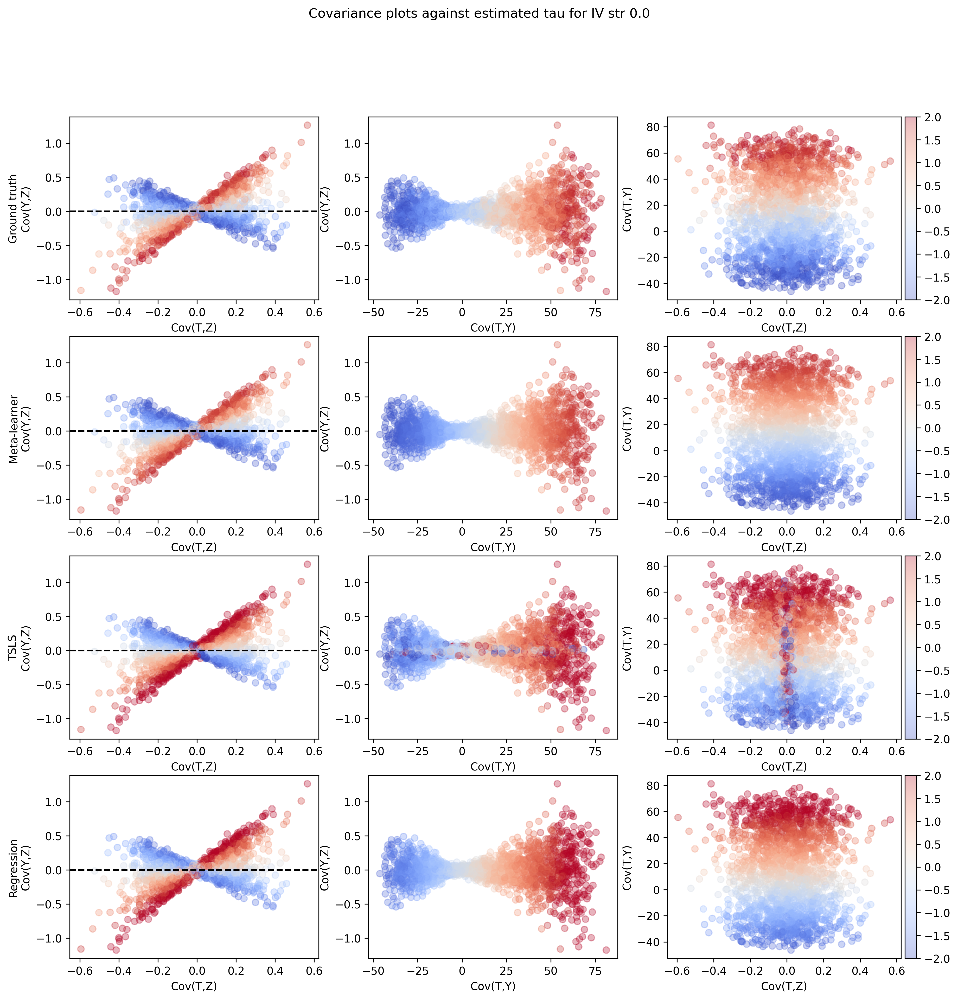

In [17]:
fig, axs = plt.subplots(4, 3, figsize=(14, 14), dpi=300)
fig.patch.set_color("white")
print(axs.shape)

COV_TY = 8
COV_YZ = 7
COV_TZ = 6

idx = 0

X_test = test_feats[idx]

# ground truth
ax1, ax2, ax3 = axs[0]
y = test_taus[idx]
sc = ax1.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax1.set_xlabel("Cov(T,Z)")
ax1.set_ylabel("Ground truth\nCov(Y,Z)")
sc = ax2.scatter(x=X_test[:,COV_TY], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax2.set_xlabel("Cov(T,Y)")
ax2.set_ylabel("Cov(Y,Z)")
sc = ax3.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_TY], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax3.set_xlabel("Cov(T,Z)")
ax3.set_ylabel("Cov(T,Y)")
ax1.axhline(y=0, ls='--', color='black')

divider = make_axes_locatable(ax3)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(sc, cax=cax, orientation='vertical')

# ml
ax1, ax2, ax3 = axs[1]
y = ml_preds[idx]
sc = ax1.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax1.set_xlabel("Cov(T,Z)")
ax1.set_ylabel("Meta-learner\nCov(Y,Z)")
sc = ax2.scatter(x=X_test[:,COV_TY], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax2.set_xlabel("Cov(T,Y)")
ax2.set_ylabel("Cov(Y,Z)")
sc = ax3.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_TY], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax3.set_xlabel("Cov(T,Z)")
ax3.set_ylabel("Cov(T,Y)")
ax1.axhline(y=0, ls='--', color='black')

divider = make_axes_locatable(ax3)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(sc, cax=cax, orientation='vertical')

# tsls
ax1, ax2, ax3 = axs[2]
y = iv_preds[idx]
sc = ax1.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax1.set_xlabel("Cov(T,Z)")
ax1.set_ylabel("TSLS\nCov(Y,Z)")
sc = ax2.scatter(x=X_test[:,COV_TY], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax2.set_xlabel("Cov(T,Y)")
ax2.set_ylabel("Cov(Y,Z)")
sc = ax3.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_TY], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax3.set_xlabel("Cov(T,Z)")
ax3.set_ylabel("Cov(T,Y)")
ax1.axhline(y=0, ls='--', color='black')

divider = make_axes_locatable(ax3)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(sc, cax=cax, orientation='vertical')

# reg
ax1, ax2, ax3 = axs[3]
y = reg_preds[idx]
sc = ax1.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax1.set_xlabel("Cov(T,Z)")
ax1.set_ylabel("Regression\nCov(Y,Z)")
sc = ax2.scatter(x=X_test[:,COV_TY], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax2.set_xlabel("Cov(T,Y)")
ax2.set_ylabel("Cov(Y,Z)")
sc = ax3.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_TY], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax3.set_xlabel("Cov(T,Z)")
ax3.set_ylabel("Cov(T,Y)")

ax1.axhline(y=0, ls='--', color='black')
divider = make_axes_locatable(ax3)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(sc, cax=cax, orientation='vertical')
plt.suptitle("Covariance plots against estimated tau for IV str {}".format(iv_strs[idx]))

(4, 3)


Text(0.5, 0.98, 'Covariance plots against estimated tau for IV str 1.0')

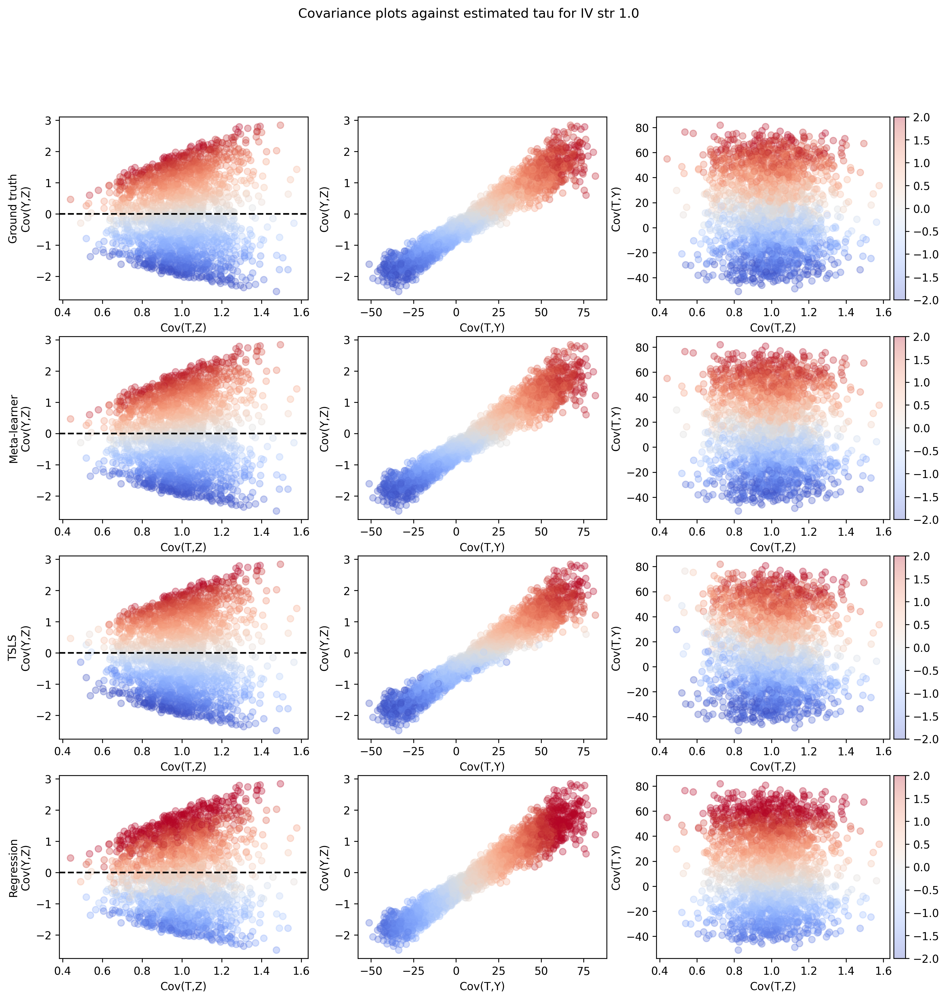

In [18]:
fig, axs = plt.subplots(4, 3, figsize=(14, 14), dpi=300)
fig.patch.set_color("white")
print(axs.shape)

COV_TY = 8
COV_YZ = 7
COV_TZ = 6

idx = 5

X_test = test_feats[idx]

# ground truth
ax1, ax2, ax3 = axs[0]
y = test_taus[idx]
sc = ax1.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax1.set_xlabel("Cov(T,Z)")
ax1.set_ylabel("Ground truth\nCov(Y,Z)")
sc = ax2.scatter(x=X_test[:,COV_TY], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax2.set_xlabel("Cov(T,Y)")
ax2.set_ylabel("Cov(Y,Z)")
sc = ax3.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_TY], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax3.set_xlabel("Cov(T,Z)")
ax3.set_ylabel("Cov(T,Y)")
ax1.axhline(y=0, ls='--', color='black')

divider = make_axes_locatable(ax3)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(sc, cax=cax, orientation='vertical')

# ml
ax1, ax2, ax3 = axs[1]
y = ml_preds[idx]
sc = ax1.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax1.set_xlabel("Cov(T,Z)")
ax1.set_ylabel("Meta-learner\nCov(Y,Z)")
sc = ax2.scatter(x=X_test[:,COV_TY], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax2.set_xlabel("Cov(T,Y)")
ax2.set_ylabel("Cov(Y,Z)")
sc = ax3.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_TY], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax3.set_xlabel("Cov(T,Z)")
ax3.set_ylabel("Cov(T,Y)")
ax1.axhline(y=0, ls='--', color='black')

divider = make_axes_locatable(ax3)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(sc, cax=cax, orientation='vertical')

# tsls
ax1, ax2, ax3 = axs[2]
y = iv_preds[idx]
sc = ax1.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax1.set_xlabel("Cov(T,Z)")
ax1.set_ylabel("TSLS\nCov(Y,Z)")
sc = ax2.scatter(x=X_test[:,COV_TY], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax2.set_xlabel("Cov(T,Y)")
ax2.set_ylabel("Cov(Y,Z)")
sc = ax3.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_TY], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax3.set_xlabel("Cov(T,Z)")
ax3.set_ylabel("Cov(T,Y)")
ax1.axhline(y=0, ls='--', color='black')

divider = make_axes_locatable(ax3)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(sc, cax=cax, orientation='vertical')

# reg
ax1, ax2, ax3 = axs[3]
y = reg_preds[idx]
sc = ax1.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax1.set_xlabel("Cov(T,Z)")
ax1.set_ylabel("Regression\nCov(Y,Z)")
sc = ax2.scatter(x=X_test[:,COV_TY], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax2.set_xlabel("Cov(T,Y)")
ax2.set_ylabel("Cov(Y,Z)")
sc = ax3.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_TY], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax3.set_xlabel("Cov(T,Z)")
ax3.set_ylabel("Cov(T,Y)")

ax1.axhline(y=0, ls='--', color='black')
divider = make_axes_locatable(ax3)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(sc, cax=cax, orientation='vertical')
plt.suptitle("Covariance plots against estimated tau for IV str {}".format(iv_strs[idx]))

In [ ]:
fig, axs = plt.subplots(4, 3, figsize=(14, 14), dpi=300)
fig.patch.set_color("white")
print(axs.shape)

COV_TY = 8
COV_YZ = 7
COV_TZ = 6

idx = 10

X_test = test_feats[idx]

# ground truth
ax1, ax2, ax3 = axs[0]
y = test_taus[idx]
sc = ax1.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax1.set_xlabel("Cov(T,Z)")
ax1.set_ylabel("Ground truth\nCov(Y,Z)")
sc = ax2.scatter(x=X_test[:,COV_TY], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax2.set_xlabel("Cov(T,Y)")
ax2.set_ylabel("Cov(Y,Z)")
sc = ax3.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_TY], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax3.set_xlabel("Cov(T,Z)")
ax3.set_ylabel("Cov(T,Y)")
ax1.axhline(y=0, ls='--', color='black')

divider = make_axes_locatable(ax3)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(sc, cax=cax, orientation='vertical')

# ml
ax1, ax2, ax3 = axs[1]
y = ml_preds[idx]
sc = ax1.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax1.set_xlabel("Cov(T,Z)")
ax1.set_ylabel("Meta-learner\nCov(Y,Z)")
sc = ax2.scatter(x=X_test[:,COV_TY], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax2.set_xlabel("Cov(T,Y)")
ax2.set_ylabel("Cov(Y,Z)")
sc = ax3.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_TY], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax3.set_xlabel("Cov(T,Z)")
ax3.set_ylabel("Cov(T,Y)")
ax1.axhline(y=0, ls='--', color='black')

divider = make_axes_locatable(ax3)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(sc, cax=cax, orientation='vertical')

# tsls
ax1, ax2, ax3 = axs[2]
y = iv_preds[idx]
sc = ax1.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax1.set_xlabel("Cov(T,Z)")
ax1.set_ylabel("TSLS\nCov(Y,Z)")
sc = ax2.scatter(x=X_test[:,COV_TY], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax2.set_xlabel("Cov(T,Y)")
ax2.set_ylabel("Cov(Y,Z)")
sc = ax3.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_TY], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax3.set_xlabel("Cov(T,Z)")
ax3.set_ylabel("Cov(T,Y)")
ax1.axhline(y=0, ls='--', color='black')

divider = make_axes_locatable(ax3)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(sc, cax=cax, orientation='vertical')

# reg
ax1, ax2, ax3 = axs[3]
y = reg_preds[idx]
sc = ax1.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax1.set_xlabel("Cov(T,Z)")
ax1.set_ylabel("Regression\nCov(Y,Z)")
sc = ax2.scatter(x=X_test[:,COV_TY], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax2.set_xlabel("Cov(T,Y)")
ax2.set_ylabel("Cov(Y,Z)")
sc = ax3.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_TY], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax3.set_xlabel("Cov(T,Z)")
ax3.set_ylabel("Cov(T,Y)")

ax1.axhline(y=0, ls='--', color='black')
divider = make_axes_locatable(ax3)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(sc, cax=cax, orientation='vertical')
plt.suptitle("Covariance plots against estimated tau for IV str {}".format(iv_strs[idx]))

In [ ]:
fig, ax = plt.subplots(dpi=300)
fig.patch.set_color("white")

ax.plot(iv_strs, reg_mses, label="linear reg")
ax.plot(iv_strs, iv_mses, label="TSLS")
ax.plot(iv_strs, ml_mses, label="supervised learner")
#ax.plot(iv_strs, wald_mses, label="Cov(Y,Z) / Cov(T,Z)")
ax.legend()
ax.set_ylim(0, 0.25)
ax.set_ylabel("MSE")
ax.set_xlabel("IV strength ")
ax.set_title("MSE for n=2000, confounded treatment, 10k datasets")

In [ ]:
feat_array = np.array(feat_importances)

In [ ]:
fig, ax = plt.subplots(dpi=300)
fig.patch.set_color("white")

for i in range(10):
    ax.plot(iv_strs, feat_array[:, i], label=feat_cols[i])
ax.legend()
#ax.set_ylim(0, 0.025)
ax.set_ylabel("feature importance")
ax.set_xlabel("IV strength ")
ax.set_title("Feature importances for n=1000, confounded treatment, 10k datasets")

# Bias-variance decomp sandbox

# Regression and TSLS sandbox

In [ ]:
def train_model(idx, train_data, lm_model, formula):
    resample_df = train_data.sample(frac=1, replace=True, random_state=idx)
    result = lm_model.from_formula(formula, data=resample_df).fit()
    return result.params['T']


def linmodels_bias_var_tradeoff(train_data, lm_model, formula, n_boot=50):
    """
    Computes the bias and variance of a model fit on a given dataset.

    Args:
        train_data (np.array): training data
        lm_model (function): a linearmodels model, here either IV2SLS or _OLS
        formula (str): Patsy-string representation of the regression to be fit
    """
    f_args = [(idx, train_data, lm_model, formula) for idx in range(n_boot)]
    
    with multiprocessing.Pool(12) as pool:
        results = pool.starmap(train_model, f_args)
        
    return results


In [ ]:
n_datasets = 10000
n_test_datasets = 10
n_boot = 100


iv_mses = []
reg_mses = []

iv_stderrs = []
iv_preds = []
reg_preds = []

mean_reg_bias = []
mean_reg_vars = []

mean_iv_bias = []
mean_iv_vars = []

for pi in tqdm(iv_strs):
    print(pi)
    lin_reg_taus = np.zeros(n_test_datasets)
    tsls_taus = np.zeros(n_test_datasets)
    tsls_stderrs = np.zeros(n_test_datasets)
    test_taus = np.zeros(n_test_datasets)

    lin_reg_biases = np.zeros(n_test_datasets)
    lin_reg_vars = np.zeros(n_test_datasets)
    
    tsls_biases = np.zeros(n_test_datasets)
    tsls_vars = np.zeros(n_test_datasets)


    for i in range(n_test_datasets):
        seed = i + int(pi*10000) # to ensure we have non-overlapping datasets
        np.random.seed(seed)
        
        treat_effect = np.random.uniform(-2, 2)
        confound_effect = np.random.uniform(1, 5)
        psi_effect = np.random.uniform(5, 10)
        n_samples = 1000
        #n_samples = int(np.random.uniform(500, 5000))
        
        data_df = generate_const_linear_iv(
            n_samples=n_samples,
            seed=seed,
            pi=pi,
            psi=psi,
            tau=treat_effect,
            gamma=confound_effect)
        
        lin_reg = LinearRegression()

        lin_reg.fit(data_df['T'].values.reshape(-1,1), data_df['Y'])
        tsls = IV2SLS.from_formula('Y ~ 1 + [T ~ Z]',
                                   data=data_df)    
        iv_res = tsls.fit()
        
        lin_reg_taus[i] = lin_reg.coef_[0]
        tsls_taus[i] = iv_res.params['T']
        tsls_stderrs[i] = iv_res.std_errors['T']
        test_taus[i] = treat_effect

        # bias/var tradeoff
        boot_train_tau_hat_tsls = linmodels_bias_var_tradeoff(data_df, IV2SLS, 'Y ~ 1 + [T ~ Z]', n_boot=n_boot)
        boot_train_tau_hat_linreg = linmodels_bias_var_tradeoff(data_df, _OLS, 'Y ~ T', n_boot=n_boot)
        #         for boot_idx in range(n_boot): 
        #             resample_df = data_df.sample(frac=1, replace=True, random_state=seed+boot_idx)


        #             #lin_reg.fit(resample_df['T'].values.reshape(-1,1), resample_df['Y'])
        #             lin_reg = _OLS.from_formula('Y ~ 1 + T', 
        #                                        data=resample_df).fit()

        #             iv = IV2SLS.from_formula('Y ~ 1 + [T ~ Z]',
        #                                    data=resample_df).fit(cov_type="unadjusted")

        #             boot_train_tau_hat_tsls.append(iv.params['T'])
        #             boot_train_tau_hat_linreg.append(lin_reg.params['T'])
        #boot_train_tau_hat_linreg.append(lin_reg.coef_[0])
        
        tsls_biases[i] = (test_taus[i] - np.mean(boot_train_tau_hat_tsls)) ** 2
        tsls_vars[i] = np.var(boot_train_tau_hat_tsls)

        lin_reg_biases[i] = (test_taus[i] - np.mean(boot_train_tau_hat_linreg)) ** 2
        lin_reg_vars[i] = np.var(boot_train_tau_hat_linreg)
        
        
    mean_reg_bias.append(np.mean(lin_reg_biases))
    mean_reg_vars.append(np.mean(lin_reg_vars))

    mean_iv_bias.append(np.mean(tsls_biases))
    mean_iv_vars.append(np.mean(tsls_vars))
    
    iv_preds.append(tsls_taus)
    iv_stderrs.append(tsls_stderrs)
    reg_preds.append(lin_reg_taus)
    
    iv_mses.append(mse(tsls_taus, test_taus))
    reg_mses.append(mse(lin_reg_taus, test_taus))
    #break

In [ ]:
reg_mses

In [ ]:
mean_reg_bias

## ML bias sandbox

In [ ]:
def train_ml_model(idx, X_train, y_train, X_test):
    np.random.seed(idx)
    indices = np.arange(X_train.shape[0])
    resample_indices = np.random.choice(indices, size=indices.shape[0], replace=True)
    
    model = RandomForestRegressor(random_state=idx, n_estimators=100, n_jobs=12)
    
    model.fit(X_train[resample_indices], y_train[resample_indices])
    
    return model.predict(X_test)


def ml_bias_var_tradeoff(X_train, y_train, X_test, n_boot=50):
    """
    Computes the bias and variance of a model fit on a given dataset.

    Args:
        train_data (np.array): training data
        lm_model (function): a linearmodels model, here either IV2SLS or _OLS
        formula (str): Patsy-string representation of the regression to be fit
    """
    f_args = [(idx, X_train, y_train, X_test) for idx in range(n_boot)]
    
    with multiprocessing.Pool(12) as pool:
        results = pool.starmap(train_ml_model, f_args)
    
    return np.array(results)


In [ ]:
pi
psi

In [ ]:
ml_mses = []
ml_preds = []

mean_ml_bias = []
mean_ml_vars = []
ml_avg_loss = []
ml_noise = []

wald_preds = []
wald_mses = []

test_taus = []
test_feats = []
test_stderrs = []
feat_importances = []

n_datasets = 5000
n_test_datasets = 2000
n_boot = 5

for pi in tqdm(iv_strs):
    data = np.zeros((n_datasets, 10))
    taus = np.zeros(n_datasets)
    confounds = np.zeros(n_datasets)
    
    ml_bias = np.zeros(n_datasets)
    ml_var = np.zeros(n_datasets)
    
    for i in range(n_datasets):
        seed = i + int(pi*10000) # to ensure we have non-overlapping datasets
        
        treat_effect = np.random.uniform(-2, 2)
        confound_effect = np.random.uniform(1, 5)
        psi_effect = np.random.uniform(5, 10)
        n_samples = 1000
        
        # TODO need to split this, somehow
        data_df = generate_const_linear_iv(
            n_samples=n_samples,
            seed=seed,
            pi=pi,
            psi=psi_effect,
            tau=treat_effect,
            gamma=confound_effect)
        
        feats = generate_iv_features(data_df)
        data[i,:] = feats
        

        
        taus[i] = treat_effect
        confounds[i] = confound_effect
    
    
    # zero out the variance terms
    #data[:, 0:8] = 0
    #data[:, feat_cols.index("var_Y")] = 0
    #data[:, feat_cols.index("mean_Y")] = 0
    #data[:, feat_cols.index("var_T")] = 0
    #data[:, feat_cols.index("var_Z")] = 0
    
    X_train = data[n_test_datasets:, :]
    X_test = data[:n_test_datasets, :]

    y_train = taus[n_test_datasets:]
    y_test = taus[:n_test_datasets]
    
    #print(X_test.shape)
    #print(y_test.shape)
    
    meta_learner = RandomForestRegressor(random_state=42, n_estimators=100, n_jobs=12)
    meta_learner.fit(X_train, y_train)
    
    preds = meta_learner.predict(X_test)
    #RegressionForest(random_state=42, n_estimators=100)
    
    # bias variance decomp
    boot_tau_hat_ml = ml_bias_var_tradeoff(X_train, y_train, X_test, n_boot=n_boot)

    ml_bias = (y_test - np.mean(boot_tau_hat_ml, axis=0)) ** 2
    ml_vars = np.var(boot_tau_hat_ml, axis=0)
    
    #     avg_mse, avg_bias, avg_var = bias_variance_decomp(meta_learner, X_train, y_train, X_test, y_test.reshape(-1,1), 
    #                                                       random_seed=42, loss='mse', num_rounds=100)
    #     ml_bias.append(avg_bias)
    #     ml_vars.append(avg_var)
    #     ml_avg_loss.append(avg_mse)
    
    
    
#     y_noise = np.var(y_test)
#     y_bias = np.mean((y_test - np.mean(preds)) ** 2)
#     y_var = np.var(preds)
    
    mean_ml_bias.append(np.mean(ml_bias))
    mean_ml_vars.append(np.mean(ml_vars))
    #ml_noise.append(y_noise)
    
    #std_err = meta_learner.prediction_stderr(X_test)
    
    #        Cov(Z,Y)       Cov(T,Z)
    #wald = X_test[:, 7] / X_test[:, 6]
    #wald_preds.append(wald)
    
    ml_preds.append(preds)
    test_taus.append(y_test)
    test_feats.append(X_test)
    #test_stderrs.append(std_err)
    
    feat_importances.append(meta_learner.feature_importances_)
    #print(meta_learner.coef_)
    ml_mses.append(mse(preds, y_test))
    #wald_mses.append(mse(wald, y_test))
    


## Learned representation sandbox

In [19]:
import torch
import torch.nn as nn
from train_liv_nn import JointAutoencoder
import pickle
datasets = pickle.load(open("c9/datasets.pkl", "rb"))


In [20]:

nn_mses = []
latents = []
test_ys = []
nn_tau_hats = []
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

for pi in iv_strs:
    model = torch.load("joint_autoencoder_{}.pt".format(pi))
    model.eval()
    test_data = datasets[pi]['test_data']
    test_x, test_y = next(iter(test_data))
    test_x = test_x.to(torch.float32).to(device)
    test_y = test_y.to(torch.float32).to(device)
    
    with torch.no_grad():
        _, z, tau_hat = model(test_x)
        tau_hat = tau_hat.squeeze()
        nn_tau_hats.append(tau_hat.cpu().detach().numpy())
        #print(tau_hat.shape)
        #print(test_y.shape)
        test_loss = nn.MSELoss()(tau_hat, test_y).cpu().item()
        nn_mses.append(test_loss)
        latents.append(z.cpu().detach().numpy())
        test_ys.append(test_y.cpu().detach().numpy())


In [21]:
len(test_ys)

11

Text(0.5, 1.0, 'MSE for n=2000, confounded treatment, 10k datasets')

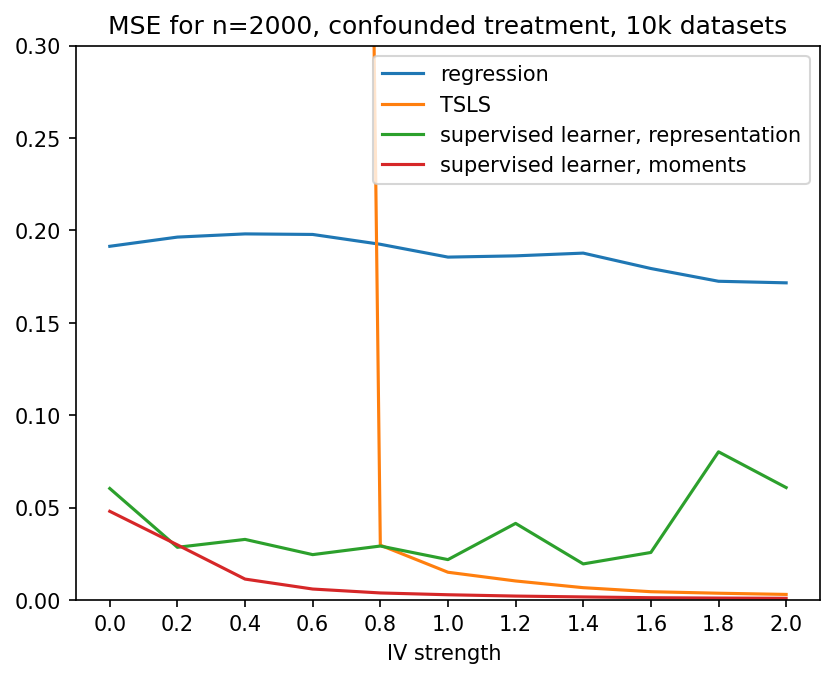

In [22]:
fig, ax = plt.subplots(dpi=150)
fig.patch.set_color("white")

# ax.plot(iv_strs, mean_ml_bias, label="ml bias^2")
# ax.plot(iv_strs, mean_ml_vars, label="ml variance")
# ax.plot(iv_strs, mean_reg_bias, label="reg bias^2")
# ax.plot(iv_strs, mean_reg_vars, label="reg variance")
# ax.plot(iv_strs, mean_iv_bias, label="iv bias^2")
# ax.plot(iv_strs, mean_iv_vars, label="iv variance")
ax.plot(iv_strs, reg_mses, label="regression")
ax.plot(iv_strs, wald_mses, label="TSLS")
ax.plot(iv_strs, nn_mses, label="supervised learner, representation")
ax.plot(iv_strs, ml_mses, label="supervised learner, moments")

ax.legend(loc="upper right")
ax.set_ylim(0, 0.3)
ax.set_xticks(iv_strs)
ax.set_ylabel("")
ax.set_xlabel("IV strength ")
ax.set_title("MSE for n=2000, confounded treatment, 10k datasets")

(5, 3)


Text(0.5, 0.98, 'Covariance plots against estimated tau for IV str 2.0')

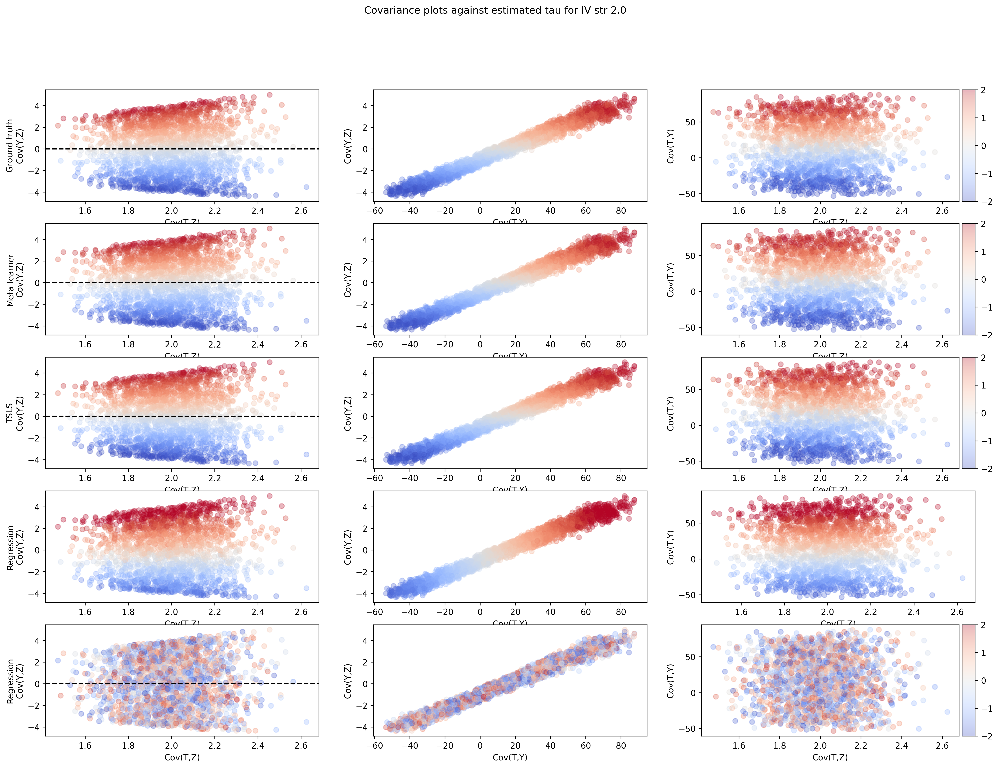

In [23]:
fig, axs = plt.subplots(5, 3, figsize=(20,14), dpi=300)
fig.patch.set_color("white")
print(axs.shape)

COV_TY = 8
COV_YZ = 7
COV_TZ = 6

idx = 10

X_test = test_feats[idx]#test_feats[idx]

x = latents[idx][:, 0]
y = latents[idx][:, 1]
# ground truth
ax1, ax2, ax3 = axs[0]
c = test_taus[idx]
sc = ax1.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_YZ], c=c, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax1.set_xlabel("Cov(T,Z)")
ax1.set_ylabel("Ground truth\nCov(Y,Z)")
sc = ax2.scatter(x=X_test[:,COV_TY], y=X_test[:, COV_YZ], c=c, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax2.set_xlabel("Cov(T,Y)")
ax2.set_ylabel("Cov(Y,Z)")
sc = ax3.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_TY], c=c, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax3.set_xlabel("Cov(T,Z)")
ax3.set_ylabel("Cov(T,Y)")
ax1.axhline(y=0, ls='--', color='black')

divider = make_axes_locatable(ax3)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(sc, cax=cax, orientation='vertical')

# ml
ax1, ax2, ax3 = axs[1]
y = ml_preds[idx]
sc = ax1.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax1.set_xlabel("Cov(T,Z)")
ax1.set_ylabel("Meta-learner\nCov(Y,Z)")
sc = ax2.scatter(x=X_test[:,COV_TY], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax2.set_xlabel("Cov(T,Y)")
ax2.set_ylabel("Cov(Y,Z)")
sc = ax3.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_TY], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax3.set_xlabel("Cov(T,Z)")
ax3.set_ylabel("Cov(T,Y)")
ax1.axhline(y=0, ls='--', color='black')

divider = make_axes_locatable(ax3)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(sc, cax=cax, orientation='vertical')

# tsls
ax1, ax2, ax3 = axs[2]
y = iv_preds[idx]
sc = ax1.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax1.set_xlabel("Cov(T,Z)")
ax1.set_ylabel("TSLS\nCov(Y,Z)")
sc = ax2.scatter(x=X_test[:,COV_TY], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax2.set_xlabel("Cov(T,Y)")
ax2.set_ylabel("Cov(Y,Z)")
sc = ax3.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_TY], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax3.set_xlabel("Cov(T,Z)")
ax3.set_ylabel("Cov(T,Y)")
ax1.axhline(y=0, ls='--', color='black')

divider = make_axes_locatable(ax3)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(sc, cax=cax, orientation='vertical')

# reg
ax1, ax2, ax3 = axs[3]
y = reg_preds[idx]
sc = ax1.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax1.set_xlabel("Cov(T,Z)")
ax1.set_ylabel("Regression\nCov(Y,Z)")
sc = ax2.scatter(x=X_test[:,COV_TY], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax2.set_xlabel("Cov(T,Y)")
ax2.set_ylabel("Cov(Y,Z)")
sc = ax3.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_TY], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax3.set_xlabel("Cov(T,Z)")
ax3.set_ylabel("Cov(T,Y)")

# learned rep
ax1, ax2, ax3 = axs[4]
y = nn_tau_hats[idx]
#X_test = latents[idx]
#COV_TZ = 0
#COV_TY = 1
#COV_YZ = 2
sc = ax1.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax1.set_xlabel("Cov(T,Z)")
ax1.set_ylabel("Regression\nCov(Y,Z)")
sc = ax2.scatter(x=X_test[:,COV_TY], y=X_test[:, COV_YZ], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax2.set_xlabel("Cov(T,Y)")
ax2.set_ylabel("Cov(Y,Z)")
sc = ax3.scatter(x=X_test[:,COV_TZ], y=X_test[:, COV_TY], c=y, cmap='coolwarm', alpha=0.3, vmin=-2, vmax=2)
ax3.set_xlabel("Cov(T,Z)")
ax3.set_ylabel("Cov(T,Y)")

ax1.axhline(y=0, ls='--', color='black')
divider = make_axes_locatable(ax3)
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(sc, cax=cax, orientation='vertical')
plt.suptitle("Covariance plots against estimated tau for IV str {}".format(iv_strs[idx]))

In [52]:
feat_array = np.array(feat_importances)

IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

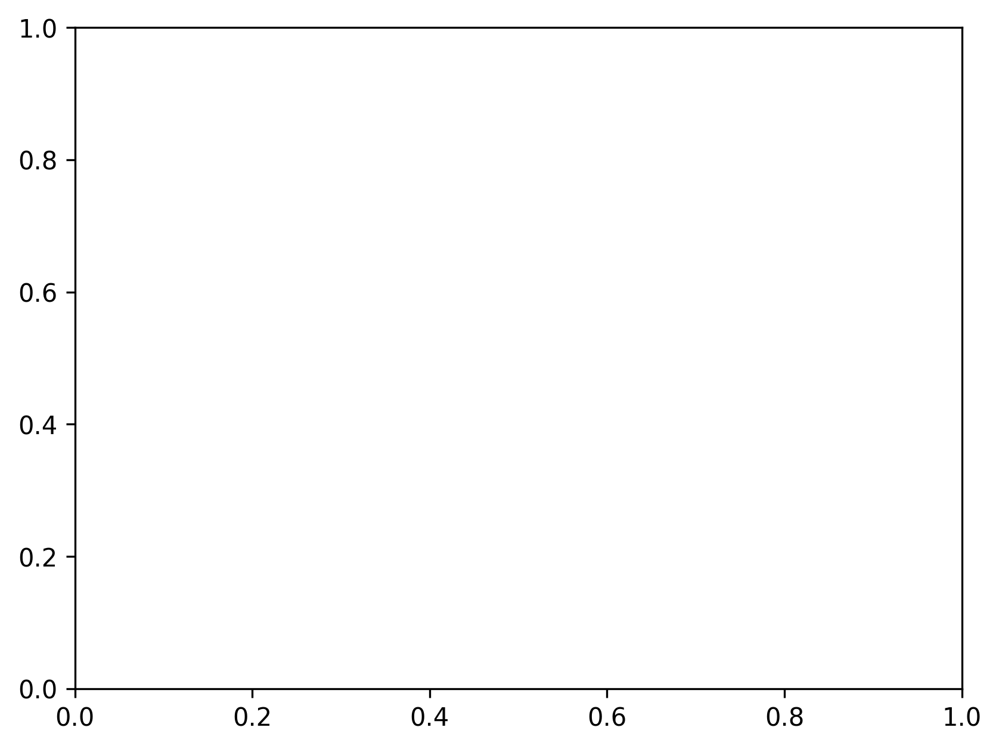

In [53]:
fig, ax = plt.subplots(dpi=300)
fig.patch.set_color("white")

for i in range(10):
    ax.plot(iv_strs, feat_array[:, i], label=feat_cols[i])
ax.legend()
#ax.set_ylim(0, 0.025)
ax.set_ylabel("feature importance")
ax.set_xlabel("IV strength ")
ax.set_title("Feature importances for n=1000, confounded treatment, 10k datasets")

## Test on flu data

In [ ]:
%%time
data = np.zeros((n_datasets, 10))
taus = np.zeros(n_datasets)
confounds = np.zeros(n_datasets)

pi = 0.5

for i in tqdm(range(n_datasets)):
    seed = i + int(pi*10000) # to ensure we have non-overlapping datasets

    treat_effect = np.random.uniform(-2, 2)
    confound_effect = np.random.uniform(1, 5)
    n_samples = int(np.random.uniform(500, 5000))
    pi = np.random.uniform(0, 2)
    #n_samples = 1000

    data_df = generate_const_linear_iv(
        n_samples=n_samples,
        seed=seed,
        pi=pi,
        psi=psi,
        tau=treat_effect,
        gamma=confound_effect)

    feats = generate_iv_features(data_df)
    data[i,:] = feats
    taus[i] = treat_effect
    confounds[i] = confound_effect

X_train = data[n_test_datasets:, :]
X_test = data[:n_test_datasets, :]

y_train = taus[n_test_datasets:]
y_test = taus[:n_test_datasets]



In [ ]:
%%time
meta_learner = RegressionForest(random_state=42, n_estimators=100)
meta_learner.fit(X_train, y_train)
preds = meta_learner.predict(X_test)

mse(preds, y_test)

In [ ]:
flu_df = pd.read_stata("../data/flu_clean.dta")

In [ ]:
flu_df.head()

In [ ]:
sel_df = flu_df[flu_df['female'] == 1][['assign', 'receive', 'outcome']]
#sel_df = flu_df[['assign', 'receive', 'outcome']]

In [ ]:
sel_df = sel_df.rename({
    'assign': 'Z',
    'receive': 'T',
    'outcome': 'Y'
}, axis='columns')

In [ ]:
flu_feats = generate_iv_features(sel_df)

In [ ]:
flu_feats

In [ ]:
meta_learner.predict(flu_feats)

In [ ]:
meta_learner.predict_interval(flu_feats)

In [ ]:
meta_learner.prediction_stderr(flu_feats)

# Setup: LATE

**TODO**